In [1]:
import pandas as pd

# load csv data
df = pd.read_csv("./data/wines.csv")

df.head(20)

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,type
0,7.0,0.27,0.36,20.70,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6,white
1,6.3,0.30,0.34,1.60,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6,white
2,8.1,0.28,0.40,6.90,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6,white
3,7.2,0.23,0.32,8.50,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6,white
4,7.2,0.23,0.32,8.50,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6,white
5,8.1,0.28,0.40,6.90,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6,white
6,6.2,0.32,0.16,7.00,0.045,30.0,136.0,0.9949,3.18,0.47,9.6,6,white
7,7.0,0.27,0.36,20.70,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6,white
8,6.3,0.30,0.34,1.60,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6,white
9,8.1,0.22,0.43,1.50,0.044,28.0,129.0,0.9938,3.22,0.45,11.0,6,white


I will try to predict, what type of wine a wine is.

In [2]:
target = "type"
df["type"].describe()

count      6497
unique        2
top       white
freq       4898
Name: type, dtype: object

There are two types of wine – red and white.

Let's try applying `RandomForestClassifier` to the data without any modifications.
The target column will be "type", that is either "red" or "white".
I do not even have to convert target variable to numerical / boolean type.

In [3]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, cohen_kappa_score, roc_auc_score, precision_score, recall_score, f1_score

# given features dataframe and target dataframe,
# create train test split and get RandomForestClassifier score
def print_score(X, y):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)
    model = RandomForestClassifier(n_estimators=100, max_depth=5, random_state=42)
    model.fit(X_train, y_train)
    y_predicted = model.predict(X_test)
    print(f"Accuracy score: {accuracy_score(y_test, y_predicted)}")
    print(f"Cohen kappa score: {cohen_kappa_score(y_test, y_predicted)}")
    # do not compute ROC AUC score when values are not binary, i. e. they are string labels
    if len(y_predicted) > 0 and not isinstance(y_predicted[0], str):
        print(f"Precision score: {precision_score(y_test, y_predicted)}")
        print(f"Recall score: {recall_score(y_test, y_predicted)}")
        print(f"F1 score: {f1_score(y_test, y_predicted)}")
        print(f"ROC AUC score: {roc_auc_score(y_test, y_predicted)}")
    # same as accuracy score
    # print(f"Score: {model.score(X_test, y_test)}")

# split dataframe into: 
#  - dataframe without target
#  - target dataframe
def get_X_and_y(data, target=target):
    features = data.columns.drop(target)
    X = data[features]
    y = data[target]
    
    return X, y

X, y = get_X_and_y(df)
print_score(X, y)

Accuracy score: 0.993006993006993
Cohen kappa score: 0.9808490692379804


The score is more than 99%, which is well above the expected and desired result.
The data do not need any further modifications, as those will probably lead only to worse score.

Furter (unnecessary) analysis follows...

In [4]:
from pandas_profiling import ProfileReport

# generate report to get the first insight into what the data is about
ProfileReport(df, title="Wines DF profiling")

Summarize dataset:   0%|          | 0/26 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Imported AutoViz_Class version: 0.0.81. Call using:
    from autoviz.AutoViz_Class import AutoViz_Class
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0,
                            lowess=False,chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 saves plots in your local machine under AutoViz_Plots directory and does not display charts.
Shape of your Data Set: (6497, 13)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  11
    Number of Integer-Categorical Columns =  1
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0

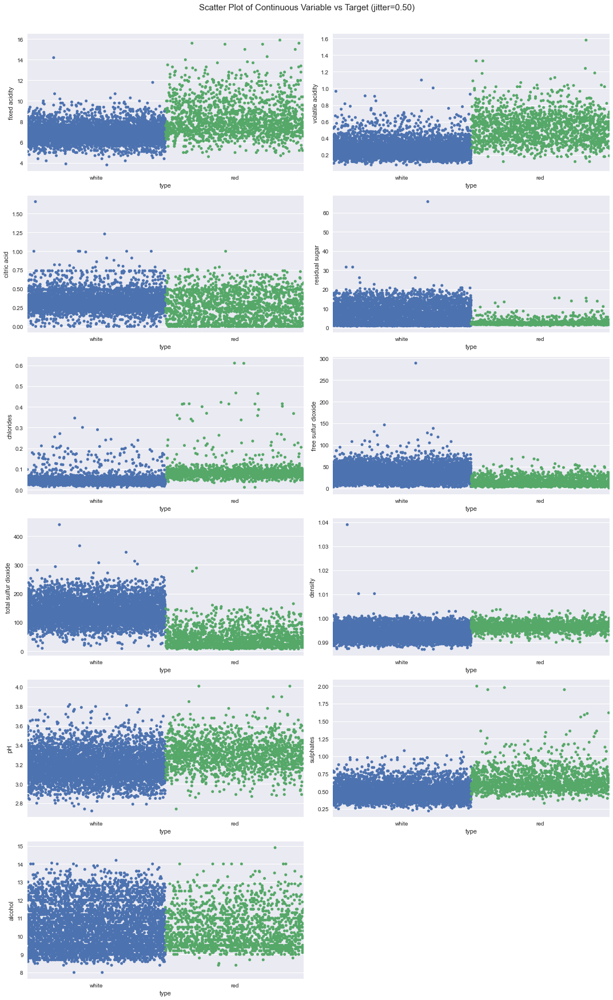

Total Number of Scatter Plots = 66


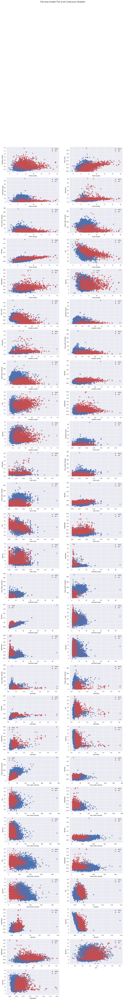

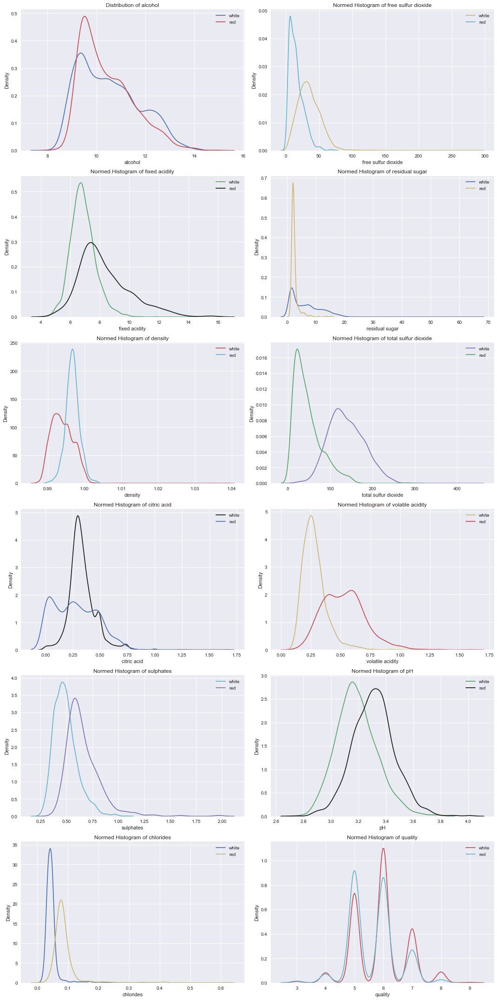

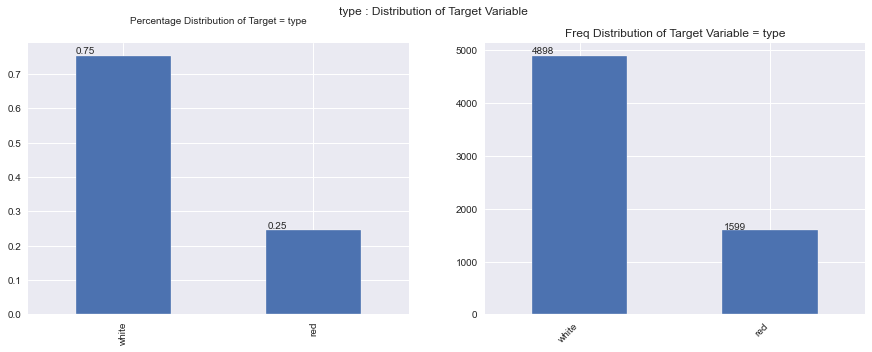

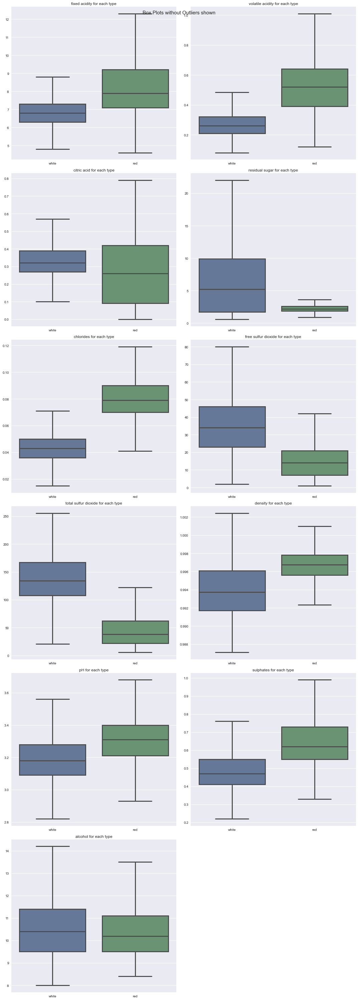

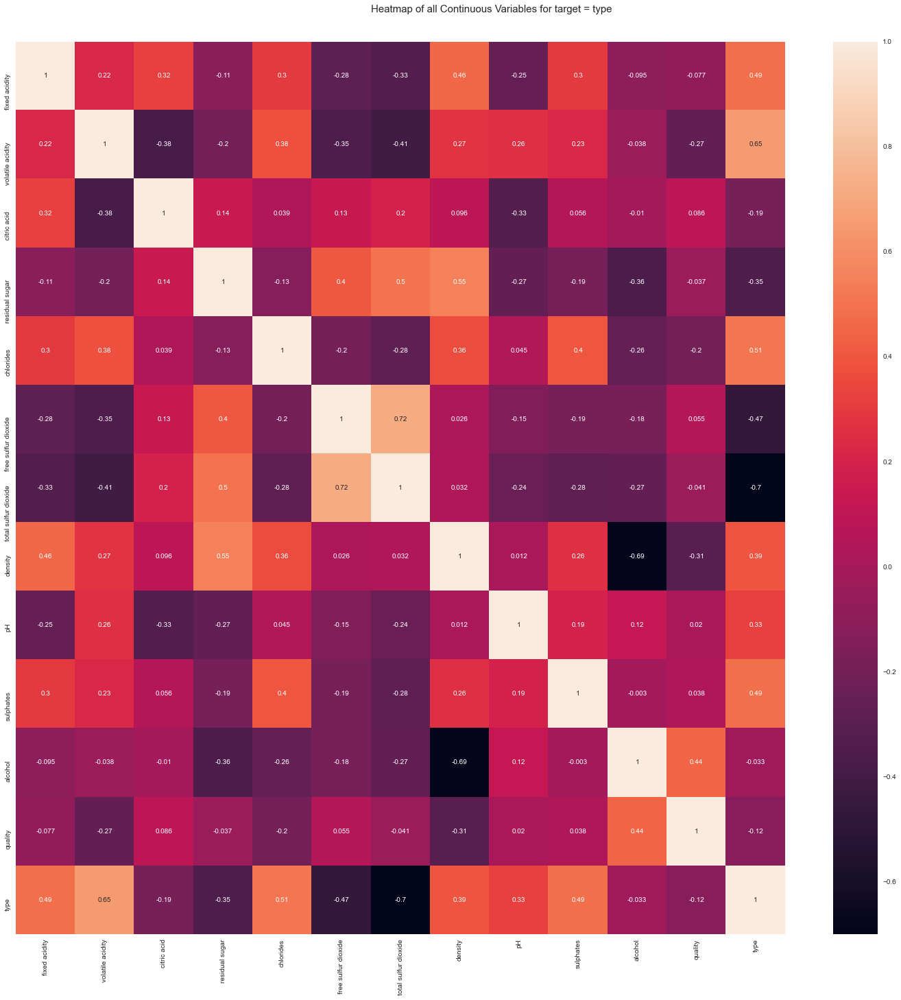

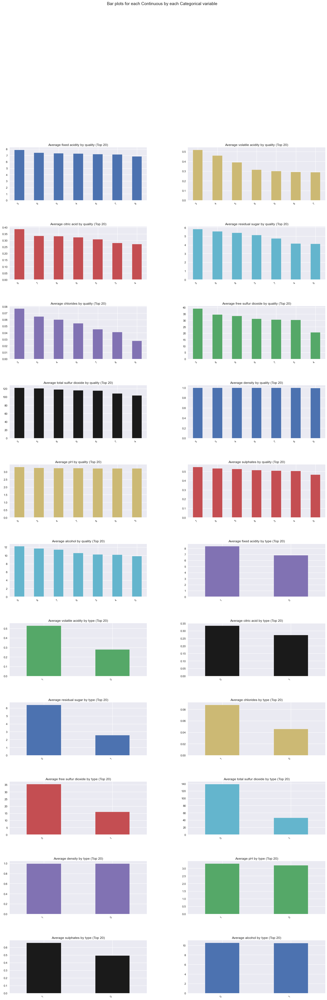

Time to run AutoViz (in seconds) = 24.049

 ###################### VISUALIZATION Completed ########################


In [6]:
from autoviz.AutoViz_Class import AutoViz_Class
av = AutoViz_Class()

visual = av.AutoViz(filename="", depVar="type", dfte=df)

In [7]:
# find out whether there are any columns with NaN values 
df.isna().any()

fixed acidity           False
volatile acidity        False
citric acid             False
residual sugar          False
chlorides               False
free sulfur dioxide     False
total sulfur dioxide    False
density                 False
pH                      False
sulphates               False
alcohol                 False
quality                 False
type                    False
dtype: bool

There are none, so there is no need for any kind of imputation or rows/columns deletion.

In [8]:
# lets find out the default assigned types of columns
print(df.dtypes)
df

fixed acidity           float64
volatile acidity        float64
citric acid             float64
residual sugar          float64
chlorides               float64
free sulfur dioxide     float64
total sulfur dioxide    float64
density                 float64
pH                      float64
sulphates               float64
alcohol                 float64
quality                   int64
type                     object
dtype: object


,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,type
0,7.0,0.270,0.36,20.7,0.045,45.0,170.0,1.00100,3.00,0.45,8.8,6,white
1,6.3,0.300,0.34,1.6,0.049,14.0,132.0,0.99400,3.30,0.49,9.5,6,white
2,8.1,0.280,0.40,6.9,0.050,30.0,97.0,0.99510,3.26,0.44,10.1,6,white
3,7.2,0.230,0.32,8.5,0.058,47.0,186.0,0.99560,3.19,0.40,9.9,6,white
4,7.2,0.230,0.32,8.5,0.058,47.0,186.0,0.99560,3.19,0.40,9.9,6,white
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6492,6.2,0.600,0.08,2.0,0.090,32.0,44.0,0.99490,3.45,0.58,10.5,5,red
6493,5.9,0.550,0.10,2.2,0.062,39.0,51.0,0.99512,3.52,0.76,11.2,6,red
6494,6.3,0.510,0.13,2.3,0.076,29.0,40.0,0.99574,3.42,0.75,11.0,6,red
6495,5.9,0.645,0.12,2.0,0.075,32.0,44.0,0.99547,3.57,0.71,10.2,5,red


Looking at the data, all the values are numerical. There are no categories, strings, booleans etc.

In [9]:
# I could, although it is not needed, convert target column to categorical type
categorical_target_df = df.astype({target:'category'})
print(categorical_target_df.dtypes)

# now I can get the categories
categorical_target_df[target].cat.categories.tolist()

fixed acidity            float64
volatile acidity         float64
citric acid              float64
residual sugar           float64
chlorides                float64
free sulfur dioxide      float64
total sulfur dioxide     float64
density                  float64
pH                       float64
sulphates                float64
alcohol                  float64
quality                    int64
type                    category
dtype: object


['red', 'white']

In [10]:
# this has no influence on the score
X, y = get_X_and_y(categorical_target_df)
print_score(X, y)

Accuracy score: 0.993006993006993
Cohen kappa score: 0.9808490692379804


In [11]:
# or transform it into a boolean value
boolean_target_df = df.replace({"type": {'white': True, 'red': False}})
boolean_target_df

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,type
0,7.0,0.270,0.36,20.7,0.045,45.0,170.0,1.00100,3.00,0.45,8.8,6,True
1,6.3,0.300,0.34,1.6,0.049,14.0,132.0,0.99400,3.30,0.49,9.5,6,True
2,8.1,0.280,0.40,6.9,0.050,30.0,97.0,0.99510,3.26,0.44,10.1,6,True
3,7.2,0.230,0.32,8.5,0.058,47.0,186.0,0.99560,3.19,0.40,9.9,6,True
4,7.2,0.230,0.32,8.5,0.058,47.0,186.0,0.99560,3.19,0.40,9.9,6,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6492,6.2,0.600,0.08,2.0,0.090,32.0,44.0,0.99490,3.45,0.58,10.5,5,False
6493,5.9,0.550,0.10,2.2,0.062,39.0,51.0,0.99512,3.52,0.76,11.2,6,False
6494,6.3,0.510,0.13,2.3,0.076,29.0,40.0,0.99574,3.42,0.75,11.0,6,False
6495,5.9,0.645,0.12,2.0,0.075,32.0,44.0,0.99547,3.57,0.71,10.2,5,False


In [12]:
# having boolean target values allows me to compute ROC AUC score as well
X, y = get_X_and_y(boolean_target_df)
print_score(X, y)

Accuracy score: 0.993006993006993
Cohen kappa score: 0.9808490692379804
Precision score: 0.9920489296636086
Recall score: 0.9987684729064039
F1 score: 0.9953973611537281
ROC AUC score: 0.9869082287756588


In [14]:
# given that target value is now boolean, I can generate the report again and look on the correlations
ProfileReport(boolean_target_df, title="Wines DF profiling")

Summarize dataset:   0%|          | 0/26 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

I can see, that wine type correlates with volatile accidity and total sulfur dioxide.

In [15]:
print(boolean_target_df["type"].corr(boolean_target_df["volatile acidity"]))
print(boolean_target_df["type"].corr(boolean_target_df["total sulfur dioxide"]))

-0.6530355891787227
0.7003571552968031


There are many (1177) duplicate rows.
Let's remove those and see how the model perfoms then.

In [16]:
print(f"There are {df.duplicated().sum()} duplicated rows.")

without_duplicates_df = df.drop_duplicates()

X, y = get_X_and_y(without_duplicates_df)
print_score(X, y)

There are 1177 duplicated rows.
Accuracy score: 0.989749430523918
Cohen kappa score: 0.9724144190690303


The model performs slightly worse, but it is closer to what can be expected in a real world, as this model could - thanks to duplicates - learn on the same example as it was guessing a label for.
Also, looking back, I think that those are not really duplicates, but rather similar wines rated in a same way.

There are 4898 (75.4%) white wines but only 1599 (24.6%) red wines. That means, that model that guesses that the wine is always white will perform reasonably well (accuracy of 75.4%) on this dataset.
Let's create a dataset containing same number of both types of wines.

In [17]:
white = df[df[target] == "white"]
red = df[df[target] == "red"]
diff = len(white) - len(red)

# shuffle white wines
shuffled_white = white.sample(frac=1, random_state=1).reset_index(drop="True") # specifying drop=True prevents 
                                                                               # .reset_index from creating a column
                                                                               # containing the old index entries.
# get only part of them to have the same number of both types 
shorter_white = shuffled_white.iloc[diff:]

# merge the two dataframes
same_number_of_each_type_df = pd.concat([red, shorter_white])

# let's find out how this affected our model
X, y = get_X_and_y(same_number_of_each_type_df)
print_score(X, y)

Accuracy score: 0.990530303030303
Cohen kappa score: 0.9810491859763977


The model might be slightly worse. 
Although most of the time, the accuracy depends on how the sample is made.
If it were the case and model really were worse, this could be caused by lower number of samples.
Let's create a dataframe that has the same number of samples to compare.

In [18]:
# shuffle our original dataset
shuffled_df = df.sample(frac=1, random_state=1).reset_index(drop="True")

# get only part of them to have the same number as when we had the same number of white and red wines 
shorter_df = shuffled_df.iloc[:len(same_number_of_each_type_df)]

# let's find out how this affected our model
X, y = get_X_and_y(shorter_df)
print_score(X, y)

Accuracy score: 0.9933712121212122
Cohen kappa score: 0.9812107285926348


We see, that even this number of samples is enough for mostly the same performant model.